In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import seaborn as sns

from sklearn.preprocessing import StandardScaler, RobustScaler
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from sklearn.metrics import confusion_matrix, classification_report


In [2]:
import platform
from matplotlib import font_manager, rc

path = "c:/Windows/Fonts/malgun.ttf"

if platform.system() == "Darwin":
    print("Hangul OK in your MAC!!!")
    rc("font", family="Arial Unicode MS")
elif platform.system() == "Windows":
    font_name = font_manager.FontProperties(fname=path).get_name()
    print("Hangul OK in your Windows!!!")
    rc("font", family=font_name)
else:
    print("Unknown system.. sorry~~~")
    
plt.rcParams["axes.unicode_minus"] = False 

Hangul OK in your Windows!!!


In [3]:
df_customer_vip = pd.read_csv('../data/df_customer_vip.csv', index_col=0)
df_customer_vip.info()

<class 'pandas.core.frame.DataFrame'>
Index: 1468 entries, 0 to 1467
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   고객ID       1468 non-null   object 
 1   성별         1468 non-null   object 
 2   고객지역       1468 non-null   object 
 3   가입기간       1468 non-null   int64  
 4   recency    1468 non-null   int64  
 5   frequency  1468 non-null   int64  
 6   monetary   1468 non-null   float64
 7   제품카테고리     1468 non-null   object 
 8   쿠폰상태       1468 non-null   object 
 9   평균구매가치     1468 non-null   float64
 10  고객가치       1468 non-null   float64
 11  고객수명       1468 non-null   int64  
 12  고객생애가치     1468 non-null   float64
 13  vip        1468 non-null   object 
dtypes: float64(4), int64(4), object(6)
memory usage: 172.0+ KB


In [4]:
df_customer_vip

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,남,Chicago,12,340,297,36683.62,Nest-USA,Clicked,123.513872,36683.62,1,36683.62,non-vip
1,USER_0190,남,California,43,14,44,3069.51,Nest-USA,Clicked,69.761591,3069.51,10,30695.10,vip
2,USER_0066,남,Chicago,33,152,42,3024.89,Apparel,Clicked,72.021190,3024.89,6,18149.34,non-vip
3,USER_0345,여,California,30,365,1,7.74,Lifestyle,Clicked,7.740000,7.74,1,7.74,non-vip
4,USER_0683,남,California,49,124,6,883.78,Nest-USA,Clicked,147.296667,883.78,7,6186.46,non-vip
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,여,New York,41,1,9,500.21,Office,Used,55.578889,500.21,10,5002.10,non-vip
1464,USER_0167,여,Chicago,48,1,19,3026.08,Nest-USA,Clicked,159.267368,3026.08,10,30260.80,vip
1465,USER_0845,남,New Jersey,19,1,5,761.86,Nest-USA,Clicked,152.372000,761.86,10,7618.60,non-vip
1466,USER_0504,여,New York,45,1,8,1100.75,Nest-USA,Clicked,137.593750,1100.75,10,11007.50,non-vip


In [5]:
df_ml = df_customer_vip.copy()

### 범주형데이터 변환

In [6]:
df_ml

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,남,Chicago,12,340,297,36683.62,Nest-USA,Clicked,123.513872,36683.62,1,36683.62,non-vip
1,USER_0190,남,California,43,14,44,3069.51,Nest-USA,Clicked,69.761591,3069.51,10,30695.10,vip
2,USER_0066,남,Chicago,33,152,42,3024.89,Apparel,Clicked,72.021190,3024.89,6,18149.34,non-vip
3,USER_0345,여,California,30,365,1,7.74,Lifestyle,Clicked,7.740000,7.74,1,7.74,non-vip
4,USER_0683,남,California,49,124,6,883.78,Nest-USA,Clicked,147.296667,883.78,7,6186.46,non-vip
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,여,New York,41,1,9,500.21,Office,Used,55.578889,500.21,10,5002.10,non-vip
1464,USER_0167,여,Chicago,48,1,19,3026.08,Nest-USA,Clicked,159.267368,3026.08,10,30260.80,vip
1465,USER_0845,남,New Jersey,19,1,5,761.86,Nest-USA,Clicked,152.372000,761.86,10,7618.60,non-vip
1466,USER_0504,여,New York,45,1,8,1100.75,Nest-USA,Clicked,137.593750,1100.75,10,11007.50,non-vip


In [7]:
from sklearn.preprocessing import LabelEncoder

# 레이블 인코딩 함수
def label_encode_column(df, column_name):
    label_encoder = LabelEncoder()
    df[column_name] = label_encoder.fit_transform(df[column_name])

# 반복문을 사용하여 각 컬럼에 대해 레이블 인코딩 적용
columns_to_encode = ['성별', '고객지역', '제품카테고리', '쿠폰상태']
for column in columns_to_encode:
    label_encode_column(df_ml, column)

df_ml

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,0,1,12,340,297,36683.62,8,0,123.513872,36683.62,1,36683.62,non-vip
1,USER_0190,0,0,43,14,44,3069.51,8,0,69.761591,3069.51,10,30695.10,vip
2,USER_0066,0,1,33,152,42,3024.89,1,0,72.021190,3024.89,6,18149.34,non-vip
3,USER_0345,1,0,30,365,1,7.74,5,0,7.740000,7.74,1,7.74,non-vip
4,USER_0683,0,0,49,124,6,883.78,8,0,147.296667,883.78,7,6186.46,non-vip
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,1,3,41,1,9,500.21,10,2,55.578889,500.21,10,5002.10,non-vip
1464,USER_0167,1,1,48,1,19,3026.08,8,0,159.267368,3026.08,10,30260.80,vip
1465,USER_0845,0,2,19,1,5,761.86,8,0,152.372000,761.86,10,7618.60,non-vip
1466,USER_0504,1,3,45,1,8,1100.75,8,0,137.593750,1100.75,10,11007.50,non-vip


In [8]:
# vip 컬럼의 값에 따라 각각의 데이터프레임을 생성
df_non_vip = df_ml[df_ml['vip'] == 'non-vip']
df_vip = df_ml[df_ml['vip'] == 'vip']
df_potential_vip = df_ml[df_ml['vip'] == '잠재적vip']

# 각각의 데이터프레임에서 랜덤하게 3개씩 샘플링
df_non_vip_sampled = df_non_vip.sample(n=3, random_state=42)
df_vip_sampled = df_vip.sample(n=3, random_state=42)
df_potential_vip_sampled = df_potential_vip.sample(n=3, random_state=42)

# 샘플링된 데이터프레임을 하나로 결합
df_final = pd.concat([df_non_vip_sampled, df_vip_sampled, df_potential_vip_sampled])

# 인덱스를 재설정
df_final.reset_index(drop=True, inplace=True)

df_final

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1049,0,3,31,181,87,8382.63,8,0,96.352069,8382.63,6,50295.78,non-vip
1,USER_0040,1,3,39,167,14,1057.78,1,0,75.555714,1057.78,6,6346.68,non-vip
2,USER_0026,0,0,32,266,147,17418.69,1,0,118.494490,17418.69,3,52256.07,non-vip
3,USER_1077,0,1,39,19,105,10925.66,1,0,104.053905,10925.66,10,109256.60,vip
4,USER_1355,0,0,21,18,572,50786.24,1,0,88.787133,50786.24,10,507862.40,vip
5,USER_1267,1,1,25,22,213,18226.01,1,0,85.568122,18226.01,10,182260.10,vip
6,USER_0414,0,1,45,64,115,11704.94,1,0,101.782087,11704.94,9,105344.46,잠재적vip
7,USER_1000,1,4,50,82,59,4776.45,1,0,80.956780,4776.45,8,38211.60,잠재적vip
8,USER_0608,1,1,26,103,59,4834.26,8,0,81.936610,4834.26,8,38674.08,잠재적vip


In [9]:
len(df_final)

9

In [10]:
# 최종 테스트 항목을 제외한 행을 삭제
values_to_drop = ['USER_1049', 'USER_0040', 'USER_0026', 'USER_1077', 
                  'USER_1355', 'USER_1267', 'USER_0414', 'USER_1000', 'USER_0608']
for value in values_to_drop:
    df_ml = df_ml[df_ml['고객ID'] != value]

In [11]:
len(df_ml)

1459

In [12]:
df_ml_copy = df_ml.copy()
df_ml_copy

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,0,1,12,340,297,36683.62,8,0,123.513872,36683.62,1,36683.62,non-vip
1,USER_0190,0,0,43,14,44,3069.51,8,0,69.761591,3069.51,10,30695.10,vip
2,USER_0066,0,1,33,152,42,3024.89,1,0,72.021190,3024.89,6,18149.34,non-vip
3,USER_0345,1,0,30,365,1,7.74,5,0,7.740000,7.74,1,7.74,non-vip
4,USER_0683,0,0,49,124,6,883.78,8,0,147.296667,883.78,7,6186.46,non-vip
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,1,3,41,1,9,500.21,10,2,55.578889,500.21,10,5002.10,non-vip
1464,USER_0167,1,1,48,1,19,3026.08,8,0,159.267368,3026.08,10,30260.80,vip
1465,USER_0845,0,2,19,1,5,761.86,8,0,152.372000,761.86,10,7618.60,non-vip
1466,USER_0504,1,3,45,1,8,1100.75,8,0,137.593750,1100.75,10,11007.50,non-vip


In [13]:
# vip 컬럼의 값을 숫자로 변환
df_ml_copy['vip'] = df_ml_copy['vip'].map({'non-vip': 3, 'vip': 1, '잠재적vip': 2})
df_ml_copy

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,0,1,12,340,297,36683.62,8,0,123.513872,36683.62,1,36683.62,3
1,USER_0190,0,0,43,14,44,3069.51,8,0,69.761591,3069.51,10,30695.10,1
2,USER_0066,0,1,33,152,42,3024.89,1,0,72.021190,3024.89,6,18149.34,3
3,USER_0345,1,0,30,365,1,7.74,5,0,7.740000,7.74,1,7.74,3
4,USER_0683,0,0,49,124,6,883.78,8,0,147.296667,883.78,7,6186.46,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,1,3,41,1,9,500.21,10,2,55.578889,500.21,10,5002.10,3
1464,USER_0167,1,1,48,1,19,3026.08,8,0,159.267368,3026.08,10,30260.80,1
1465,USER_0845,0,2,19,1,5,761.86,8,0,152.372000,761.86,10,7618.60,3
1466,USER_0504,1,3,45,1,8,1100.75,8,0,137.593750,1100.75,10,11007.50,3


### 상관관계 분석

In [14]:
df_corr = df_ml_copy.drop(columns=['고객ID']).copy()

<Axes: >

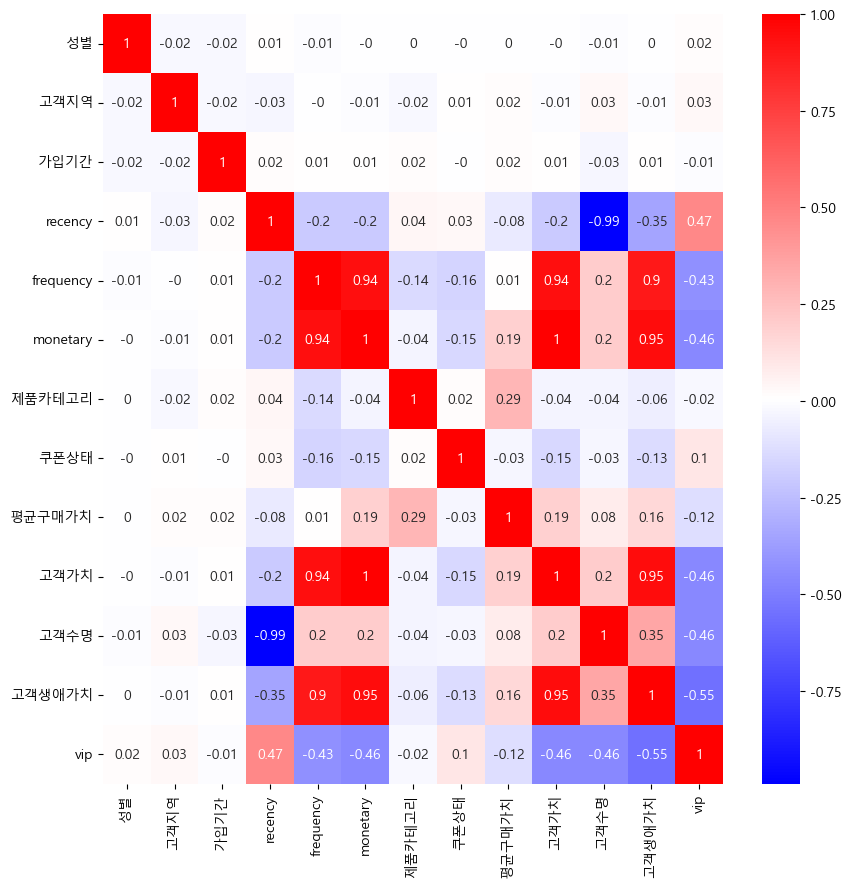

In [15]:
plt.figure(figsize=(10, 10))
correlation_matrix = df_corr.corr(numeric_only=True).round(2)
sns.heatmap(data = correlation_matrix, annot=True, cmap='bwr')

### 데이터 분포도 확인_범주형 데이터 제외
#### 가입기간, recency, frequency, monetary

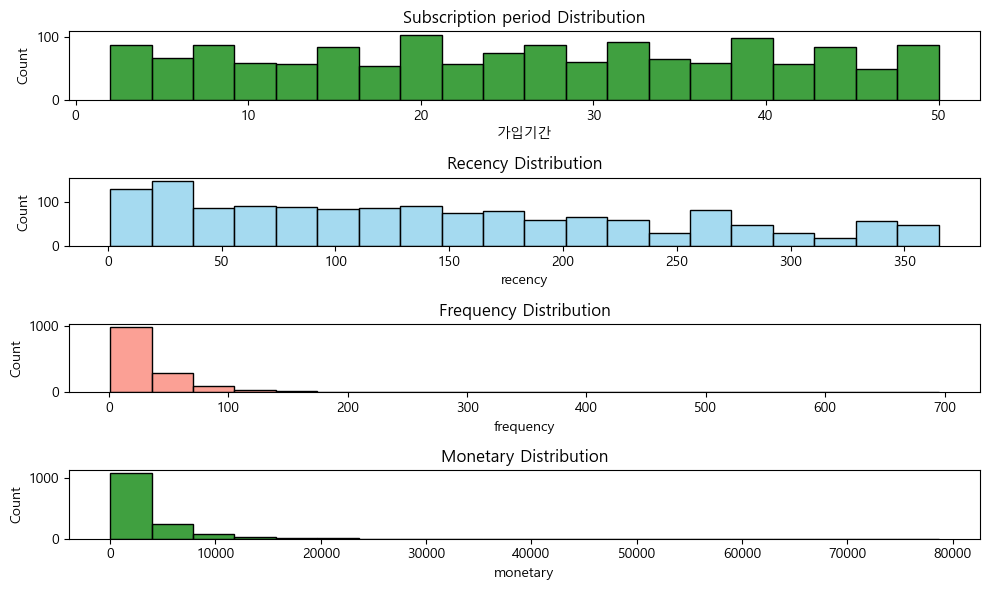

In [16]:
plt.figure(figsize=(10, 6))

plt.subplot(4, 1, 1)
sns.histplot(data=df_ml_copy, x='가입기간', bins=20,color='green')
plt.title('Subscription period Distribution')

plt.subplot(4, 1, 2)
sns.histplot(data=df_ml_copy, x='recency', bins=20, color='skyblue')
plt.title('Recency Distribution')

plt.subplot(4, 1, 3)
sns.histplot(data=df_ml_copy, x='frequency', bins=20, color='salmon')
plt.title('Frequency Distribution')

plt.subplot(4, 1, 4)
sns.histplot(data=df_ml_copy, x='monetary', bins=20,color='green')
plt.title('Monetary Distribution')

plt.tight_layout()
plt.show()

#### 평균구매가치, 고객가치, 고객수명, 고객생애가치 분포도

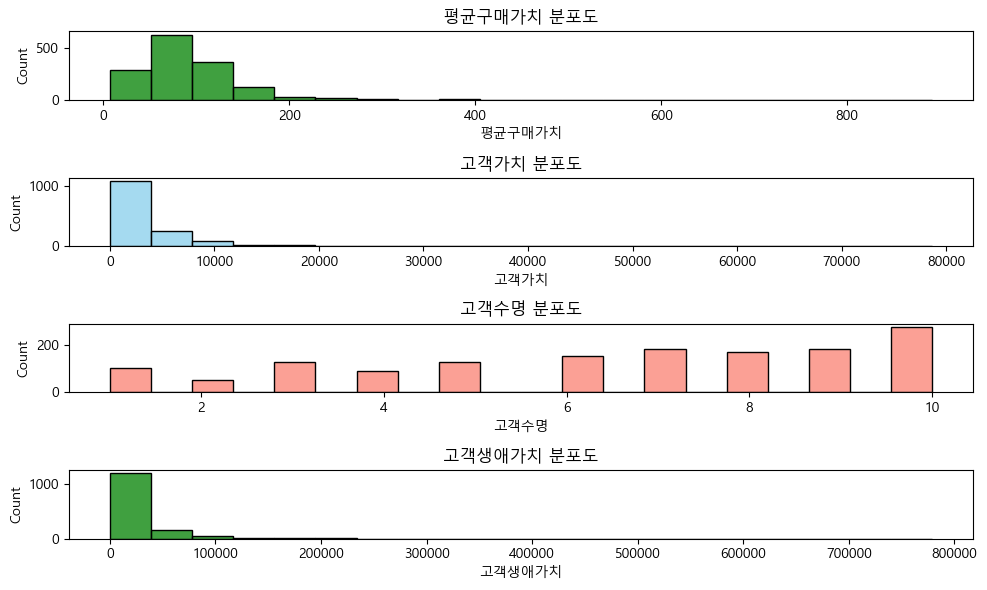

In [17]:
plt.figure(figsize=(10, 6))

plt.subplot(4, 1, 1)
sns.histplot(data=df_ml_copy, x='평균구매가치', bins=20,color='green')
plt.title('평균구매가치 분포도')

plt.subplot(4, 1, 2)
sns.histplot(data=df_ml_copy, x='고객가치', bins=20, color='skyblue')
plt.title('고객가치 분포도')

plt.subplot(4, 1, 3)
sns.histplot(data=df_ml_copy, x='고객수명', bins=20, color='salmon')
plt.title('고객수명 분포도')

plt.subplot(4, 1, 4)
sns.histplot(data=df_ml_copy, x='고객생애가치', bins=20,color='green')
plt.title('고객생애가치 분포도')

plt.tight_layout()
plt.show()

### scale_StandardScaler, RobustScaler, logsacle 비교

### StandardScaler

In [18]:
df_ml_copy.columns[1:-1]

Index(['성별', '고객지역', '가입기간', 'recency', 'frequency', 'monetary', '제품카테고리',
       '쿠폰상태', '평균구매가치', '고객가치', '고객수명', '고객생애가치'],
      dtype='object')

In [19]:
df_ml_ss = df_ml_copy.copy()
ss = StandardScaler()

for column in df_ml_ss.columns[1:-1]:
    # 2차원 배열로 변환
    column_data = df_ml_ss[column].values.reshape(-1, 1)
    # StandardScaler를 사용하여 스케일링
    scaled_data = ss.fit_transform(column_data)
    # 스케일링된 결과를 다시 해당 열에 할당
    df_ml_ss[column] = scaled_data

### RobustScaler

In [20]:
df_ml_rs = df_ml_copy.copy()
rs = RobustScaler()

for column in df_ml_rs.columns[1:-1]:
    # 2차원 배열로 변환
    column_data = df_ml_rs[column].values.reshape(-1, 1)
    # StandardScaler를 사용하여 스케일링
    scaled_data = rs.fit_transform(column_data)
    # 스케일링된 결과를 다시 해당 열에 할당
    df_ml_rs[column] = scaled_data

### logscale

In [21]:
df_ml_log = df_ml_copy.copy()

for column in df_ml_log.columns[1:-1]:
    # 2차원 배열로 변환
    column_data = df_ml_log[column].values.reshape(-1, 1)
    # StandardScaler를 사용하여 스케일링
    scaled_data = np.log1p(column_data)
    # 스케일링된 결과를 다시 해당 열에 할당
    df_ml_log[column] = scaled_data

In [22]:
df_ml_log.head()

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,0.000000,0.693147,2.564949,5.831882,5.697093,10.510113,2.197225,0.0,4.824417,10.510113,0.693147,10.510113,3
1,USER_0190,0.000000,0.000000,3.784190,2.708050,3.806662,8.029599,2.197225,0.0,4.259316,8.029599,2.397895,10.331891,1
2,USER_0066,0.000000,0.693147,3.526361,5.030438,3.761200,8.014961,0.693147,0.0,4.290750,8.014961,1.945910,9.806445,3
3,USER_0345,0.693147,0.000000,3.433987,5.902633,0.693147,2.167910,1.791759,0.0,2.167910,2.167910,0.693147,2.167910,3
4,USER_0683,0.000000,0.000000,3.912023,4.828314,1.945910,6.785339,2.197225,0.0,4.999215,6.785339,2.079442,8.730280,3


### 각 scale boxplot 시각화
- log scale 시 데이터가 아래값으로 치우쳐지지 않음을 확인하여 결정

### StandardScaler

In [23]:
df_ml_ss.columns

Index(['고객ID', '성별', '고객지역', '가입기간', 'recency', 'frequency', 'monetary',
       '제품카테고리', '쿠폰상태', '평균구매가치', '고객가치', '고객수명', '고객생애가치', 'vip'],
      dtype='object')

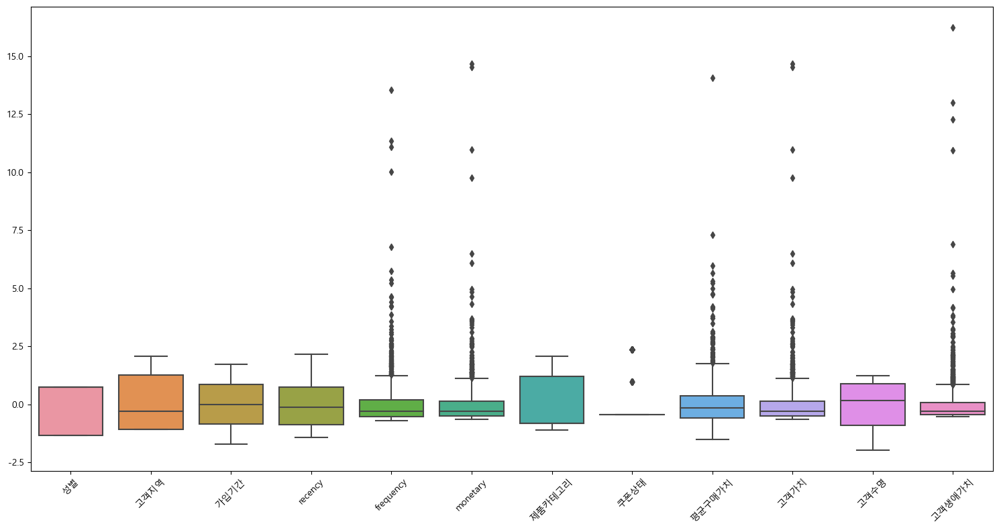

In [24]:
column = ['성별', '고객지역', '가입기간', 'recency', 'frequency', 'monetary', 
          '제품카테고리', '쿠폰상태', '평균구매가치', '고객가치', '고객수명', '고객생애가치']

plt.figure(figsize=(15, 8))
sns.boxplot(data=df_ml_ss[column])
plt.xticks(rotation=45)  # x축 레이블 회전
plt.tight_layout()
plt.show()

### RobustScaler

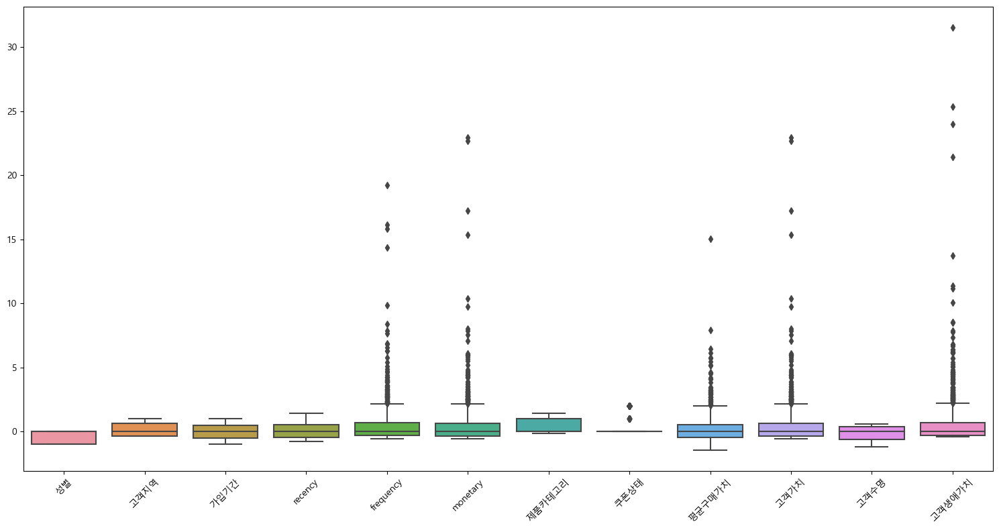

In [25]:
column = ['성별', '고객지역', '가입기간', 'recency', 'frequency', 'monetary', 
          '제품카테고리', '쿠폰상태', '평균구매가치', '고객가치', '고객수명', '고객생애가치']

plt.figure(figsize=(15, 8))
sns.boxplot(data=df_ml_rs[column])
plt.xticks(rotation=45)  # x축 레이블 회전
plt.tight_layout()
plt.show()

### logscale

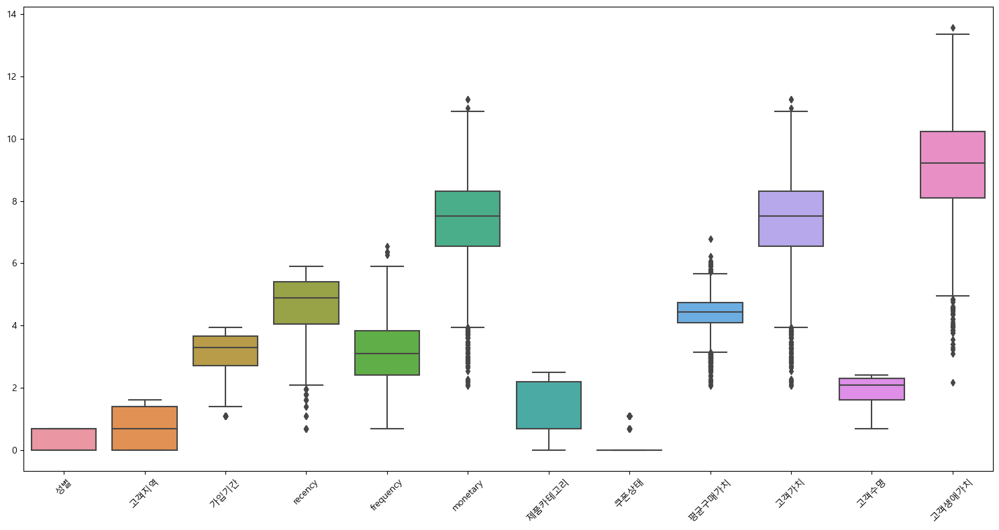

In [26]:
column = ['성별', '고객지역', '가입기간', 'recency', 'frequency', 'monetary', 
          '제품카테고리', '쿠폰상태', '평균구매가치', '고객가치', '고객수명', '고객생애가치']

plt.figure(figsize=(15, 8))
sns.boxplot(data=df_ml_log[column])
plt.xticks(rotation=45)  # x축 레이블 회전
plt.tight_layout()
plt.show()

### 원본데이터 머신러닝
### 데이터분리
- labels : vip: 1, 잠재적vip: 2, non-vip: 3

In [27]:
X = df_ml_copy.drop(columns=['고객ID', 'vip'], axis=1)
y = df_ml_copy['vip']

In [28]:
X.shape, y.shape

((1459, 12), (1459,))

In [29]:
from sklearn.model_selection import train_test_split

# 8:2 확률로 특성(features)과 정답(labels)을 분리
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2, # test_size= : 분리 기준 설정
                                                    # train : 80%, test : 20% 로 데이터 분리
                                                    stratify=y,
                                                    # stratify= : 나눈 데이터에 labels 수를 동일한 비율로 맞춰주는 설정, 
                                                    # train와 test 각각에 labels를 비슷한 비율로 유지
                                                    random_state=13)


In [30]:
X_train.shape, X_test.shape

((1167, 12), (292, 12))

In [31]:
y_train.shape, y_test.shape

((1167,), (292,))

In [32]:
# 위에서 1167, 292 개로 나눈 데이터에 3가지 속성의 값들이 동일한 비율로 들어가있는지 확인, 비율이 동일한 것이 좋은 데이터
np.unique(y_train, return_counts=True)

(array([1, 2, 3], dtype=int64), array([ 86, 112, 969], dtype=int64))

In [33]:
np.unique(y_test, return_counts=True)

(array([1, 2, 3], dtype=int64), array([ 21,  28, 243], dtype=int64))

### DecisionTreeClassifier

In [34]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=13)

# Decision Tree 분류기 생성
decision_tree = DecisionTreeClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'max_depth': [3, 6, 9],  # 의사결정트리의 최대 깊이
    'min_samples_split': [2, 5, 10],  # 내부 노드를 분할하는 데 필요한 최소 샘플 수
    'min_samples_leaf': [1, 2, 4]  # 리프 노드에 필요한 최소 샘플 수
}

original_grid_ds = GridSearchCV(estimator=decision_tree, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
original_grid_ds.fit(X_train, y_train)
dt_y_pred_train = original_grid_ds.predict(X_train)
dt_y_pred_test = original_grid_ds.predict(X_test)


In [35]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", original_grid_ds.best_params_)
print("Best accuracy found: ", original_grid_ds.best_score_)

score_df = pd.DataFrame(original_grid_ds.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'max_depth': 6, 'min_samples_leaf': 1, 'min_samples_split': 10}
Best accuracy found:  0.9811562305124537


,params,rank_test_score,mean_test_score,std_test_score
0,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",3,0.979447,0.010266
1,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",3,0.979447,0.010266
2,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",3,0.979447,0.010266
3,"{'max_depth': 3, 'min_samples_leaf': 2, 'min_s...",10,0.977730,0.010626
4,"{'max_depth': 3, 'min_samples_leaf': 2, 'min_s...",10,0.977730,0.010626


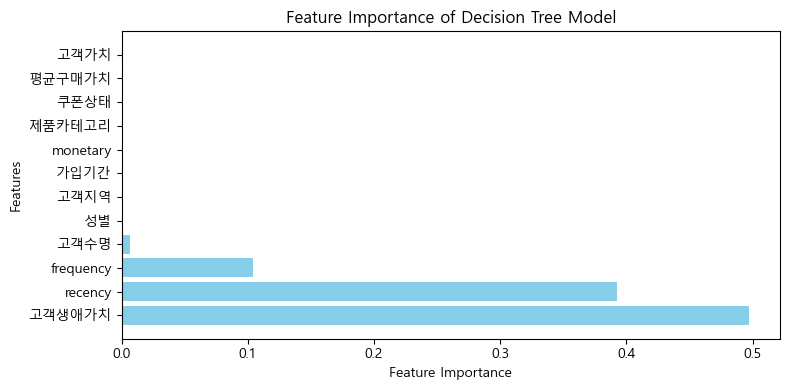

In [36]:
# 최적 모델 얻기
best_model = original_grid_ds.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of Decision Tree Model')
plt.tight_layout()
plt.show()


In [37]:
# 각 성능 지표 계산
# train
dt_tr_accuracy = accuracy_score(y_train, dt_y_pred_train)
dt_tr_precision = precision_score(y_train, dt_y_pred_train, average='weighted')
dt_tr_recall = recall_score(y_train, dt_y_pred_train, average='weighted')
dt_tr_f1 = f1_score(y_train, dt_y_pred_train, average='weighted')

# test
dt_test_accuracy = accuracy_score(y_test, dt_y_pred_test)
dt_test_precision = precision_score(y_test, dt_y_pred_test, average='weighted')
dt_test_recall = recall_score(y_test, dt_y_pred_test, average='weighted')
dt_test_f1 = f1_score(y_test, dt_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", dt_tr_accuracy)
print("Train Precision:", dt_tr_precision)
print("Train Recall:", dt_tr_recall)
print("Train F1 Score:", dt_tr_f1)
print('=' * 50)
print("Test Accuracy:", dt_test_accuracy)
print("Test Precision:", dt_test_precision)
print("Test Recall:", dt_test_recall)
print("Test F1 Score:", dt_test_f1)

Train Accuracy: 0.9922879177377892
Train Precision: 0.9925039997886068
Train Recall: 0.9922879177377892
Train F1 Score: 0.9922911166448869
Test Accuracy: 0.976027397260274
Test Precision: 0.9786218347862183
Test Recall: 0.976027397260274
Test F1 Score: 0.9755721924484556


In [38]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train, dt_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, dt_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       0.99      0.94      0.96        86
           2       0.95      1.00      0.97       112
           3       1.00      1.00      1.00       969

    accuracy                           0.99      1167
   macro avg       0.98      0.98      0.98      1167
weighted avg       0.99      0.99      0.99      1167

Test Classification Report:
              precision    recall  f1-score   support

           1       1.00      0.76      0.86        21
           2       0.85      1.00      0.92        28
           3       0.99      0.99      0.99       243

    accuracy                           0.98       292
   macro avg       0.95      0.92      0.92       292
weighted avg       0.98      0.98      0.98       292



In [39]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train, dt_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, dt_y_pred_test))

Train Confusion Matrix:
[[ 81   3   2]
 [  0 112   0]
 [  1   3 965]]
Test Confusion Matrix:
[[ 16   3   2]
 [  0  28   0]
 [  0   2 241]]


### RandomForestClassifier

In [40]:
from sklearn.ensemble import RandomForestClassifier

# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=13)

# Random Forest 분류기 생성
random_forest = RandomForestClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'n_estimators': [100, 200, 300],  # 트리의 개수
    'max_depth': [3, 6, 9],  # 트리의 최대 깊이
    'min_samples_split': [2, 5, 10],  # 내부 노드를 분할하는 데 필요한 최소 샘플 수
    'min_samples_leaf': [1, 2, 4]  # 리프 노드에 필요한 최소 샘플 수
}

original_grid_rf = GridSearchCV(estimator=random_forest, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
original_grid_rf.fit(X_train, y_train)
rf_y_pred_train = original_grid_rf.predict(X_train)
rf_y_pred_test = original_grid_rf.predict(X_test)

In [41]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", original_grid_rf.best_params_)
print("Best accuracy found: ", original_grid_rf.best_score_)

score_df = pd.DataFrame(original_grid_rf.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'max_depth': 9, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 300}
Best accuracy found:  0.9854407395179928


,params,rank_test_score,mean_test_score,std_test_score
0,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",63,0.970023,0.009716
1,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",80,0.968306,0.008772
2,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",63,0.970023,0.010447
3,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",57,0.970878,0.007800
4,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",65,0.970023,0.011130


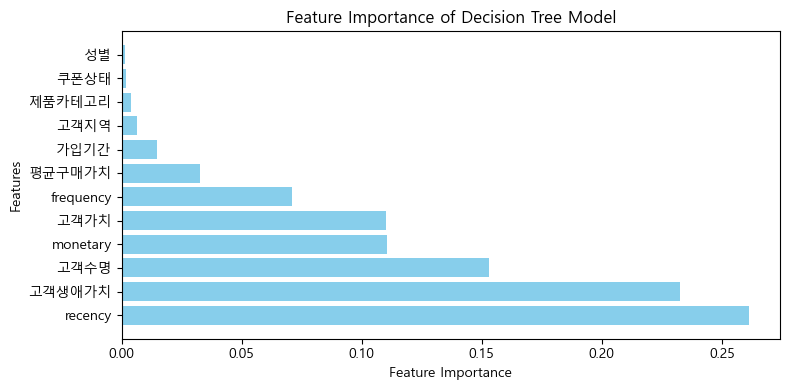

In [42]:
# 최적 모델 얻기
best_model = original_grid_rf.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of Decision Tree Model')
plt.tight_layout()
plt.show()

In [43]:
# 각 성능 지표 계산
# train
rf_tr_accuracy = accuracy_score(y_train, rf_y_pred_train)
rf_tr_precision = precision_score(y_train, rf_y_pred_train, average='weighted')
rf_tr_recall = recall_score(y_train, rf_y_pred_train, average='weighted')
rf_tr_f1 = f1_score(y_train, rf_y_pred_train, average='weighted')

# test
rf_test_accuracy = accuracy_score(y_test, rf_y_pred_test)
rf_test_precision = precision_score(y_test, rf_y_pred_test, average='weighted')
rf_test_recall = recall_score(y_test, rf_y_pred_test, average='weighted')
rf_test_f1 = f1_score(y_test, rf_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", rf_tr_accuracy)
print("Train Precision:", rf_tr_precision)
print("Train Recall:", rf_tr_recall)
print("Train F1 Score:", rf_tr_f1)
print('=' * 50)
print("Test Accuracy:", rf_test_accuracy)
print("Test Precision:", rf_test_precision)
print("Test Recall:", rf_test_recall)
print("Test F1 Score:", rf_test_f1)

Train Accuracy: 1.0
Train Precision: 1.0
Train Recall: 1.0
Train F1 Score: 1.0
Test Accuracy: 0.9931506849315068
Test Precision: 0.9932065977075761
Test Recall: 0.9931506849315068
Test F1 Score: 0.993091823046622


In [44]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train, rf_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, rf_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00        86
           2       1.00      1.00      1.00       112
           3       1.00      1.00      1.00       969

    accuracy                           1.00      1167
   macro avg       1.00      1.00      1.00      1167
weighted avg       1.00      1.00      1.00      1167

Test Classification Report:
              precision    recall  f1-score   support

           1       1.00      0.95      0.98        21
           2       1.00      0.96      0.98        28
           3       0.99      1.00      1.00       243

    accuracy                           0.99       292
   macro avg       1.00      0.97      0.98       292
weighted avg       0.99      0.99      0.99       292



In [45]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train, rf_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, rf_y_pred_test))

Train Confusion Matrix:
[[ 86   0   0]
 [  0 112   0]
 [  0   0 969]]
Test Confusion Matrix:
[[ 20   0   1]
 [  0  27   1]
 [  0   0 243]]


### LGBMClassifier

In [46]:
from lightgbm import LGBMClassifier

# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# LightGBM 분류기 생성
lgbm_classifier = LGBMClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'learning_rate': [0.01, 0.05, 0.1], # 각 트리의 가중치 업데이트에 사용되는 학습률
    'n_estimators': [100, 200, 300], # 생성할 트리의 수
    'max_depth': [3, 6, 9], 
    'min_child_weight': [1, 2, 4], # 각 트리에서 샘플의 최소 가중치 총합, 값이 높을수록 모델은 보수적으로 편향
}

original_grid_lgbm = GridSearchCV(estimator=lgbm_classifier, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
original_grid_lgbm.fit(X_train, y_train)
lgbm_y_pred_train = original_grid_lgbm.predict(X_train)
lgbm_y_pred_test = original_grid_lgbm.predict(X_test)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000415 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1446
[LightGBM] [Info] Number of data points in the train set: 933, number of used features: 12
[LightGBM] [Info] Start training from score -2.604299
[LightGBM] [Info] Start training from score -2.349769
[LightGBM] [Info] Start training from score -0.185542
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

In [47]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", original_grid_lgbm.best_params_)
print("Best accuracy found: ", original_grid_lgbm.best_score_)

score_df = pd.DataFrame(original_grid_lgbm.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'learning_rate': 0.1, 'max_depth': 6, 'min_child_weight': 2, 'n_estimators': 200}
Best accuracy found:  0.9854370712739812


,params,rank_test_score,mean_test_score,std_test_score
0,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",77,0.977734,0.008694
1,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",22,0.982873,0.007144
2,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",64,0.980302,0.007927
3,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",78,0.976879,0.010305
4,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",51,0.981156,0.005788


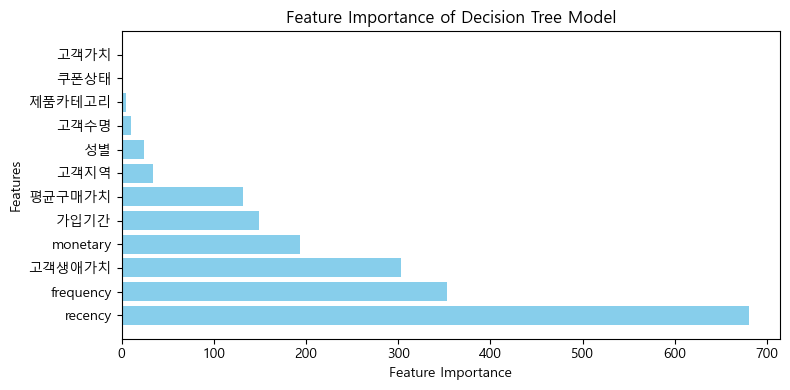

In [48]:
# 최적 모델 얻기
best_model = original_grid_lgbm.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of Decision Tree Model')
plt.tight_layout()
plt.show()

In [49]:
# 각 성능 지표 계산
# train
lgbm_tr_accuracy = accuracy_score(y_train, lgbm_y_pred_train)
lgbm_tr_precision = precision_score(y_train, lgbm_y_pred_train, average='weighted')
lgbm_tr_recall = recall_score(y_train, lgbm_y_pred_train, average='weighted')
lgbm_tr_f1 = f1_score(y_train, lgbm_y_pred_train, average='weighted')

# test
lgbm_test_accuracy = accuracy_score(y_test, lgbm_y_pred_test)
lgbm_test_precision = precision_score(y_test, lgbm_y_pred_test, average='weighted')
lgbm_test_recall = recall_score(y_test, lgbm_y_pred_test, average='weighted')
lgbm_test_f1 = f1_score(y_test, lgbm_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", lgbm_tr_accuracy)
print("Train Precision:", lgbm_tr_precision)
print("Train Recall:", lgbm_tr_recall)
print("Train F1 Score:", lgbm_tr_f1)
print('=' * 50)
print("Test Accuracy:", lgbm_test_accuracy)
print("Test Precision:", lgbm_test_precision)
print("Test Recall:", lgbm_test_recall)
print("Test F1 Score:", lgbm_test_f1)

Train Accuracy: 1.0
Train Precision: 1.0
Train Recall: 1.0
Train F1 Score: 1.0
Test Accuracy: 0.9931506849315068
Test Precision: 0.993607305936073
Test Recall: 0.9931506849315068
Test F1 Score: 0.9930975436939065


In [50]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train, lgbm_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, lgbm_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00        86
           2       1.00      1.00      1.00       112
           3       1.00      1.00      1.00       969

    accuracy                           1.00      1167
   macro avg       1.00      1.00      1.00      1167
weighted avg       1.00      1.00      1.00      1167

Test Classification Report:
              precision    recall  f1-score   support

           1       1.00      0.90      0.95        21
           2       0.93      1.00      0.97        28
           3       1.00      1.00      1.00       243

    accuracy                           0.99       292
   macro avg       0.98      0.97      0.97       292
weighted avg       0.99      0.99      0.99       292



In [51]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train, lgbm_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, lgbm_y_pred_test))

Train Confusion Matrix:
[[ 86   0   0]
 [  0 112   0]
 [  0   0 969]]
Test Confusion Matrix:
[[ 19   2   0]
 [  0  28   0]
 [  0   0 243]]


### 각 모델 별 점수

In [52]:
# 각 모델의 성능 지표를 데이터프레임으로 저장
dt_scores = pd.DataFrame({
    'Model': ['Decision Tree'],
    'Dataset': ['Test'],
    'Best estimator' : [original_grid_ds.best_estimator_],
    'Accuracy': [dt_test_accuracy],
    'Precision': [dt_test_precision],
    'Recall': [dt_test_recall],
    'F1 Score': [dt_test_f1]
})

rf_scores = pd.DataFrame({
    'Model': ['Random Forest'],
    'Dataset': ['Test'],
    'Best estimator' : [original_grid_rf.best_estimator_],
    'Accuracy': [rf_test_accuracy],
    'Precision': [rf_test_precision],
    'Recall': [rf_test_recall],
    'F1 Score': [rf_test_f1]
})

lgbm_scores = pd.DataFrame({
    'Model': ['LGBMClassifier'],
    'Dataset': ['Test'],
    'Best estimator' : [original_grid_lgbm.best_estimator_],
    'Accuracy': [lgbm_test_accuracy],
    'Precision': [lgbm_test_precision],
    'Recall': [lgbm_test_recall],
    'F1 Score': [lgbm_test_f1]
})

# 세 데이터프레임을 합치기
all_scores = pd.concat([dt_scores, rf_scores, lgbm_scores], ignore_index=True)
all_scores

,Model,Dataset,Best estimator,Accuracy,Precision,Recall,F1 Score
0,Decision Tree,Test,"DecisionTreeClassifier(max_depth=6, min_sample...",0.976027,0.978622,0.976027,0.975572
1,Random Forest,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.993151,0.993207,0.993151,0.993092
2,LGBMClassifier,Test,"LGBMClassifier(max_depth=6, min_child_weight=2...",0.993151,0.993607,0.993151,0.993098


### log scale 데이터 머신러닝
### 데이터분리
- labels : vip: 1, 잠재적vip: 2, non-vip: 3

In [53]:
df_ml_log

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1358,0.000000,0.693147,2.564949,5.831882,5.697093,10.510113,2.197225,0.000000,4.824417,10.510113,0.693147,10.510113,3
1,USER_0190,0.000000,0.000000,3.784190,2.708050,3.806662,8.029599,2.197225,0.000000,4.259316,8.029599,2.397895,10.331891,1
2,USER_0066,0.000000,0.693147,3.526361,5.030438,3.761200,8.014961,0.693147,0.000000,4.290750,8.014961,1.945910,9.806445,3
3,USER_0345,0.693147,0.000000,3.433987,5.902633,0.693147,2.167910,1.791759,0.000000,2.167910,2.167910,0.693147,2.167910,3
4,USER_0683,0.000000,0.000000,3.912023,4.828314,1.945910,6.785339,2.197225,0.000000,4.999215,6.785339,2.079442,8.730280,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1463,USER_0513,0.693147,1.386294,3.737670,0.693147,2.302585,6.217025,2.397895,1.098612,4.035636,6.217025,2.397895,8.517813,3
1464,USER_0167,0.693147,0.693147,3.891820,0.693147,2.995732,8.015354,2.197225,0.000000,5.076843,8.015354,2.397895,10.317641,1
1465,USER_0845,0.000000,1.098612,2.995732,0.693147,1.791759,6.637075,2.197225,0.000000,5.032866,6.637075,2.397895,8.938479,3
1466,USER_0504,0.693147,1.386294,3.828641,0.693147,2.197225,7.004655,2.197225,0.000000,4.931547,7.004655,2.397895,9.306423,3


In [54]:
X = df_ml_log.drop(columns=['고객ID', 'vip'], axis=1)
y = df_ml_log['vip']

In [55]:
X.shape, y.shape

((1459, 12), (1459,))

In [56]:
from sklearn.model_selection import train_test_split

# 8:2 확률로 특성(features)과 정답(labels)을 분리
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2, # test_size= : 분리 기준 설정
                                                    # train : 80%, test : 20% 로 데이터 분리
                                                    stratify=y,
                                                    # stratify= : 나눈 데이터에 labels 수를 동일한 비율로 맞춰주는 설정, 
                                                    # train와 test 각각에 labels를 비슷한 비율로 유지
                                                    random_state=13)


In [57]:
X_train.shape, X_test.shape

((1167, 12), (292, 12))

In [58]:
y_train.shape, y_test.shape

((1167,), (292,))

In [59]:
# 위에서 1167, 292 개로 나눈 데이터에 3가지 속성의 값들이 동일한 비율로 들어가있는지 확인, 비율이 동일한 것이 좋은 데이터
np.unique(y_train, return_counts=True)

(array([1, 2, 3], dtype=int64), array([ 86, 112, 969], dtype=int64))

In [60]:
np.unique(y_test, return_counts=True)

(array([1, 2, 3], dtype=int64), array([ 21,  28, 243], dtype=int64))

### DecisionTreeClassifier

In [61]:
from sklearn.model_selection import StratifiedKFold, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score


# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=13)

# Decision Tree 분류기 생성
decision_tree = DecisionTreeClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'max_depth': [3, 6, 9],  # 의사결정트리의 최대 깊이
    'min_samples_split': [2, 5, 10],  # 내부 노드를 분할하는 데 필요한 최소 샘플 수
    'min_samples_leaf': [1, 2, 4]  # 리프 노드에 필요한 최소 샘플 수
}

log_grid_ds = GridSearchCV(estimator=decision_tree, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
log_grid_ds.fit(X_train, y_train)
dt_log_y_pred_train = log_grid_ds.predict(X_train)
dt_log_y_pred_test = log_grid_ds.predict(X_test)


In [62]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", log_grid_ds.best_params_)
print("Best accuracy found: ", log_grid_ds.best_score_)

score_df = pd.DataFrame(log_grid_ds.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'max_depth': 9, 'min_samples_leaf': 1, 'min_samples_split': 2}
Best accuracy found:  0.981145225780419


,params,rank_test_score,mean_test_score,std_test_score
0,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",5,0.978588,0.009755
1,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",5,0.978588,0.009755
2,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",5,0.978588,0.009755
3,"{'max_depth': 3, 'min_samples_leaf': 2, 'min_s...",9,0.977730,0.010626
4,"{'max_depth': 3, 'min_samples_leaf': 2, 'min_s...",9,0.977730,0.010626


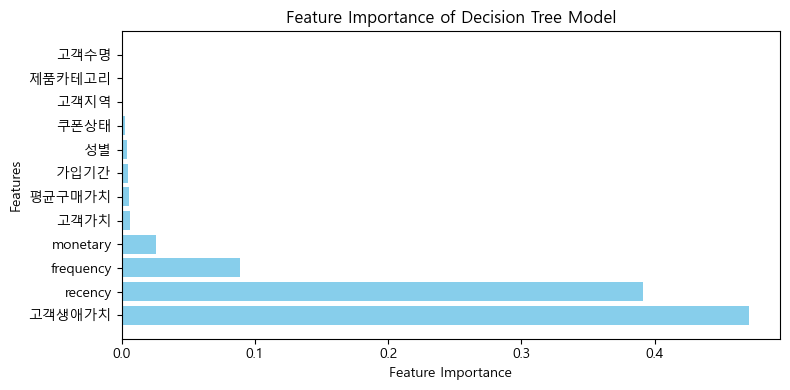

In [63]:
# 최적 모델 얻기
best_model = log_grid_ds.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of Decision Tree Model')
plt.tight_layout()
plt.show()

In [64]:
# 각 성능 지표 계산
# train
dt_log_tr_accuracy = accuracy_score(y_train, dt_log_y_pred_train)
dt_log_tr_precision = precision_score(y_train, dt_log_y_pred_train, average='weighted')
dt_log_tr_recall = recall_score(y_train, dt_log_y_pred_train, average='weighted')
dt_log_tr_f1 = f1_score(y_train, dt_log_y_pred_train, average='weighted')

# test
dt_log_test_accuracy = accuracy_score(y_test, dt_log_y_pred_test)
dt_log_test_precision = precision_score(y_test, dt_log_y_pred_test, average='weighted')
dt_log_test_recall = recall_score(y_test, dt_log_y_pred_test, average='weighted')
dt_log_test_f1 = f1_score(y_test, dt_log_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", dt_log_tr_accuracy)
print("Train Precision:", dt_log_tr_precision)
print("Train Recall:", dt_log_tr_recall)
print("Train F1 Score:", dt_log_tr_f1)
print('=' * 50)
print("Test Accuracy:", dt_log_test_accuracy)
print("Test Precision:", dt_log_test_precision)
print("Test Recall:", dt_log_test_recall)
print("Test F1 Score:", dt_log_test_f1)

Train Accuracy: 1.0
Train Precision: 1.0
Train Recall: 1.0
Train F1 Score: 1.0
Test Accuracy: 0.9828767123287672
Test Precision: 0.9834963259977584
Test Recall: 0.9828767123287672
Test F1 Score: 0.9827848575442999


In [65]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train, dt_log_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, dt_log_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00        86
           2       1.00      1.00      1.00       112
           3       1.00      1.00      1.00       969

    accuracy                           1.00      1167
   macro avg       1.00      1.00      1.00      1167
weighted avg       1.00      1.00      1.00      1167

Test Classification Report:
              precision    recall  f1-score   support

           1       0.95      0.86      0.90        21
           2       0.90      1.00      0.95        28
           3       1.00      0.99      0.99       243

    accuracy                           0.98       292
   macro avg       0.95      0.95      0.95       292
weighted avg       0.98      0.98      0.98       292



In [66]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train, dt_log_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, dt_log_y_pred_test))

Train Confusion Matrix:
[[ 86   0   0]
 [  0 112   0]
 [  0   0 969]]
Test Confusion Matrix:
[[ 18   2   1]
 [  0  28   0]
 [  1   1 241]]


### RandomForestClassifier

In [67]:
from sklearn.ensemble import RandomForestClassifier

# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=13)

# Random Forest 분류기 생성
random_forest = RandomForestClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'n_estimators': [100, 200, 300],  # 트리의 개수
    'max_depth': [3, 6, 9],  # 트리의 최대 깊이
    'min_samples_split': [2, 5, 10],  # 내부 노드를 분할하는 데 필요한 최소 샘플 수
    'min_samples_leaf': [1, 2, 4]  # 리프 노드에 필요한 최소 샘플 수
}

log_grid_rf = GridSearchCV(estimator=random_forest, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
log_grid_rf.fit(X_train, y_train)
rf_log_y_pred_train = log_grid_rf.predict(X_train)
rf_log_y_pred_test = log_grid_rf.predict(X_test)

In [68]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", log_grid_rf.best_params_)
print("Best accuracy found: ", log_grid_rf.best_score_)

score_df = pd.DataFrame(log_grid_rf.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'max_depth': 9, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
Best accuracy found:  0.9854407395179928


,params,rank_test_score,mean_test_score,std_test_score
0,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",81,0.967452,0.010310
1,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",69,0.969165,0.008692
2,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",74,0.969161,0.007327
3,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",69,0.969165,0.009872
4,"{'max_depth': 3, 'min_samples_leaf': 1, 'min_s...",61,0.970023,0.009339


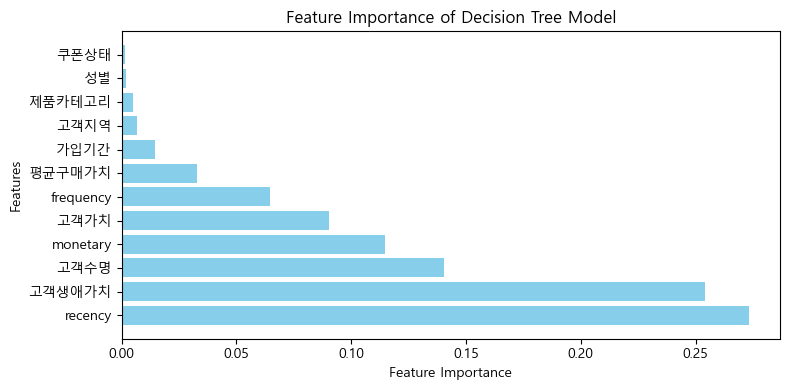

In [69]:
# 최적 모델 얻기
best_model = log_grid_rf.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of Decision Tree Model')
plt.tight_layout()
plt.show()

In [70]:
# 각 성능 지표 계산
# train
rf_log_tr_accuracy = accuracy_score(y_train, rf_log_y_pred_train)
rf_log_tr_precision = precision_score(y_train, rf_log_y_pred_train, average='weighted')
rf_log_tr_recall = recall_score(y_train, rf_log_y_pred_train, average='weighted')
rf_log_tr_f1 = f1_score(y_train, rf_log_y_pred_train, average='weighted')

# test
rf_log_test_accuracy = accuracy_score(y_test, rf_log_y_pred_test)
rf_log_test_precision = precision_score(y_test, rf_log_y_pred_test, average='weighted')
rf_log_test_recall = recall_score(y_test, rf_log_y_pred_test, average='weighted')
rf_log_test_f1 = f1_score(y_test, rf_log_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", rf_log_tr_accuracy)
print("Train Precision:", rf_log_tr_precision)
print("Train Recall:", rf_log_tr_recall)
print("Train F1 Score:", rf_log_tr_f1)
print('=' * 50)
print("Test Accuracy:", rf_log_test_accuracy)
print("Test Precision:", rf_log_test_precision)
print("Test Recall:", rf_log_test_recall)
print("Test F1 Score:", rf_log_test_f1)

Train Accuracy: 1.0
Train Precision: 1.0
Train Recall: 1.0
Train F1 Score: 1.0
Test Accuracy: 0.9931506849315068
Test Precision: 0.9932065977075761
Test Recall: 0.9931506849315068
Test F1 Score: 0.993091823046622


In [71]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train, rf_log_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, rf_log_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00        86
           2       1.00      1.00      1.00       112
           3       1.00      1.00      1.00       969

    accuracy                           1.00      1167
   macro avg       1.00      1.00      1.00      1167
weighted avg       1.00      1.00      1.00      1167

Test Classification Report:
              precision    recall  f1-score   support

           1       1.00      0.95      0.98        21
           2       1.00      0.96      0.98        28
           3       0.99      1.00      1.00       243

    accuracy                           0.99       292
   macro avg       1.00      0.97      0.98       292
weighted avg       0.99      0.99      0.99       292



In [72]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train, rf_log_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, rf_log_y_pred_test))

Train Confusion Matrix:
[[ 86   0   0]
 [  0 112   0]
 [  0   0 969]]
Test Confusion Matrix:
[[ 20   0   1]
 [  0  27   1]
 [  0   0 243]]


### LGBMClassifier

In [73]:
from lightgbm import LGBMClassifier

# StratifiedKFold를 사용한 교차 검증 설정
stratified_kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

# LightGBM 분류기 생성
lgbm_classifier = LGBMClassifier()

# GridSearchCV를 사용한 모델 검색
param_grid = {
    'learning_rate': [0.01, 0.05, 0.1], # 각 트리의 가중치 업데이트에 사용되는 학습률
    'n_estimators': [100, 200, 300], # 생성할 트리의 수
    'max_depth': [3, 6, 9], 
    'min_child_weight': [1, 2, 4], # 각 트리에서 샘플의 최소 가중치 총합, 값이 높을수록 모델은 보수적으로 편향
}

log_grid_lgbm = GridSearchCV(estimator=lgbm_classifier, param_grid=param_grid, cv=stratified_kfold, scoring='accuracy')

# 모델 학습
log_grid_lgbm.fit(X_train, y_train)
lgbm_log_y_pred_train = log_grid_lgbm.predict(X_train)
lgbm_log_y_pred_test = log_grid_lgbm.predict(X_test)

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000451 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1446
[LightGBM] [Info] Number of data points in the train set: 933, number of used features: 12
[LightGBM] [Info] Start training from score -2.604299
[LightGBM] [Info] Start training from score -2.349769
[LightGBM] [Info] Start training from score -0.185542
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fu

In [74]:
# 최적의 모델과 파라미터 출력
print("Best parameters found: ", log_grid_lgbm.best_params_)
print("Best accuracy found: ", log_grid_lgbm.best_score_)

score_df = pd.DataFrame(log_grid_lgbm.cv_results_)
score_df[['params', 'rank_test_score', 'mean_test_score', 'std_test_score']].head()

Best parameters found:  {'learning_rate': 0.1, 'max_depth': 6, 'min_child_weight': 2, 'n_estimators': 200}
Best accuracy found:  0.9854370712739812


,params,rank_test_score,mean_test_score,std_test_score
0,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",77,0.977734,0.008694
1,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",22,0.982873,0.007144
2,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",62,0.980302,0.007927
3,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",78,0.976879,0.010305
4,"{'learning_rate': 0.01, 'max_depth': 3, 'min_c...",51,0.981156,0.005788


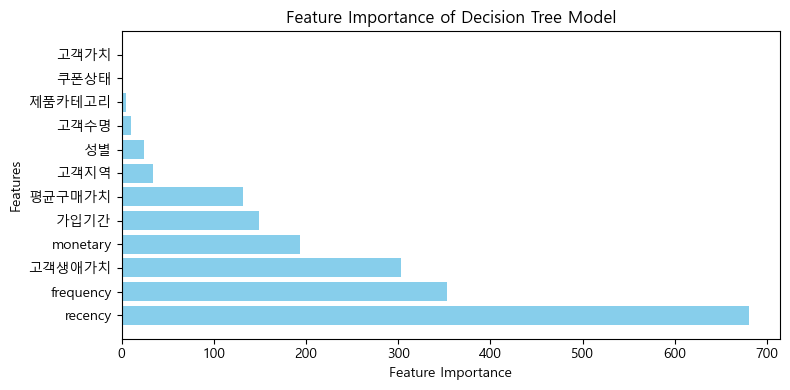

In [75]:
# 최적 모델 얻기
best_model = log_grid_lgbm.best_estimator_

# 학습된 모델에서 특성 중요도 추출
feature_importances = best_model.feature_importances_

# 특성명과 중요도를 딕셔너리로 묶기
importance_dict = dict(zip(X_train.columns, feature_importances))

# 중요도를 내림차순으로 정렬
importance_dict = dict(sorted(importance_dict.items(), key=lambda item: item[1], reverse=True))

# 중요도를 시각화
plt.figure(figsize=(8, 4))
plt.barh(list(importance_dict.keys()), list(importance_dict.values()), color='skyblue')
plt.xlabel('Feature Importance')
plt.ylabel('Features')
plt.title('Feature Importance of Decision Tree Model')
plt.tight_layout()
plt.show()

In [76]:
# 각 성능 지표 계산
# train
lgbm_log_tr_accuracy = accuracy_score(y_train, lgbm_log_y_pred_train)
lgbm_log_tr_precision = precision_score(y_train, lgbm_log_y_pred_train, average='weighted')
lgbm_log_tr_recall = recall_score(y_train, lgbm_log_y_pred_train, average='weighted')
lgbm_log_tr_f1 = f1_score(y_train, lgbm_log_y_pred_train, average='weighted')

# test
lgbm_log_test_accuracy = accuracy_score(y_test, lgbm_log_y_pred_test)
lgbm_log_test_precision = precision_score(y_test, lgbm_log_y_pred_test, average='weighted')
lgbm_log_test_recall = recall_score(y_test, lgbm_log_y_pred_test, average='weighted')
lgbm_log_test_f1 = f1_score(y_test, lgbm_log_y_pred_test, average='weighted')

# 성능 지표 출력
print("Train Accuracy:", lgbm_log_tr_accuracy)
print("Train Precision:", lgbm_log_tr_precision)
print("Train Recall:", lgbm_log_tr_recall)
print("Train F1 Score:", lgbm_log_tr_f1)
print('=' * 50)
print("Test Accuracy:", lgbm_log_test_accuracy)
print("Test Precision:", lgbm_log_test_precision)
print("Test Recall:", lgbm_log_test_recall)
print("Test F1 Score:", lgbm_log_test_f1)

Train Accuracy: 1.0
Train Precision: 1.0
Train Recall: 1.0
Train F1 Score: 1.0
Test Accuracy: 0.9931506849315068
Test Precision: 0.993607305936073
Test Recall: 0.9931506849315068
Test F1 Score: 0.9930975436939065


In [77]:
# classification report 출력
print("Train Classification Report:")
print(classification_report(y_train, lgbm_log_y_pred_train))

print("Test Classification Report:")
print(classification_report(y_test, lgbm_log_y_pred_test))

Train Classification Report:
              precision    recall  f1-score   support

           1       1.00      1.00      1.00        86
           2       1.00      1.00      1.00       112
           3       1.00      1.00      1.00       969

    accuracy                           1.00      1167
   macro avg       1.00      1.00      1.00      1167
weighted avg       1.00      1.00      1.00      1167

Test Classification Report:
              precision    recall  f1-score   support

           1       1.00      0.90      0.95        21
           2       0.93      1.00      0.97        28
           3       1.00      1.00      1.00       243

    accuracy                           0.99       292
   macro avg       0.98      0.97      0.97       292
weighted avg       0.99      0.99      0.99       292



In [78]:
# confusion matrix 출력
print("Train Confusion Matrix:")
print(confusion_matrix(y_train, lgbm_log_y_pred_train))

print("Test Confusion Matrix:")
print(confusion_matrix(y_test, lgbm_log_y_pred_test))

Train Confusion Matrix:
[[ 86   0   0]
 [  0 112   0]
 [  0   0 969]]
Test Confusion Matrix:
[[ 19   2   0]
 [  0  28   0]
 [  0   0 243]]


### 각 모델 별 점수

In [79]:
# 각 모델의 성능 지표를 데이터프레임으로 저장
dt_scores = pd.DataFrame({
    'Model': ['Decision Tree_log'],
    'Dataset': ['Test'],
    'Best estimator' : [log_grid_ds.best_estimator_],
    'Accuracy': [dt_log_test_accuracy],
    'Precision': [dt_log_test_precision],
    'Recall': [dt_log_test_recall],
    'F1 Score': [dt_log_test_f1]
})

rf_scores = pd.DataFrame({
    'Model': ['Random Forest_log'],
    'Dataset': ['Test'],
    'Best estimator' : [log_grid_rf.best_estimator_],
    'Accuracy': [rf_log_test_accuracy],
    'Precision': [rf_log_test_precision],
    'Recall': [rf_log_test_recall],
    'F1 Score': [rf_log_test_f1]
})

lgbm_scores = pd.DataFrame({
    'Model': ['LGBMClassifier_log'],
    'Dataset': ['Test'],
    'Best estimator' : [log_grid_lgbm.best_estimator_],
    'Accuracy': [lgbm_log_test_accuracy],
    'Precision': [lgbm_log_test_precision],
    'Recall': [lgbm_log_test_recall],
    'F1 Score': [lgbm_log_test_f1]
})

# 세 데이터프레임을 합치기
all_scores_log = pd.concat([dt_scores, rf_scores, lgbm_scores], ignore_index=True)

In [80]:
all_scores

,Model,Dataset,Best estimator,Accuracy,Precision,Recall,F1 Score
0,Decision Tree,Test,"DecisionTreeClassifier(max_depth=6, min_sample...",0.976027,0.978622,0.976027,0.975572
1,Random Forest,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.993151,0.993207,0.993151,0.993092
2,LGBMClassifier,Test,"LGBMClassifier(max_depth=6, min_child_weight=2...",0.993151,0.993607,0.993151,0.993098


In [81]:
all_scores_log

,Model,Dataset,Best estimator,Accuracy,Precision,Recall,F1 Score
0,Decision Tree_log,Test,DecisionTreeClassifier(max_depth=9),0.982877,0.983496,0.982877,0.982785
1,Random Forest_log,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.993151,0.993207,0.993151,0.993092
2,LGBMClassifier_log,Test,"LGBMClassifier(max_depth=6, min_child_weight=2...",0.993151,0.993607,0.993151,0.993098


In [82]:
model_score = pd.concat([all_scores, all_scores_log], ignore_index=True)
model_score

,Model,Dataset,Best estimator,Accuracy,Precision,Recall,F1 Score
0,Decision Tree,Test,"DecisionTreeClassifier(max_depth=6, min_sample...",0.976027,0.978622,0.976027,0.975572
1,Random Forest,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.993151,0.993207,0.993151,0.993092
2,LGBMClassifier,Test,"LGBMClassifier(max_depth=6, min_child_weight=2...",0.993151,0.993607,0.993151,0.993098
3,Decision Tree_log,Test,DecisionTreeClassifier(max_depth=9),0.982877,0.983496,0.982877,0.982785
4,Random Forest_log,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.993151,0.993207,0.993151,0.993092
5,LGBMClassifier_log,Test,"LGBMClassifier(max_depth=6, min_child_weight=2...",0.993151,0.993607,0.993151,0.993098


In [83]:
model_score.to_csv("../data/model_score.csv", encoding="utf-8")

In [84]:
model_score.sort_values(by=['Accuracy', 'F1 Score'], ascending=False)

,Model,Dataset,Best estimator,Accuracy,Precision,Recall,F1 Score
2,LGBMClassifier,Test,"LGBMClassifier(max_depth=6, min_child_weight=2...",0.993151,0.993607,0.993151,0.993098
5,LGBMClassifier_log,Test,"LGBMClassifier(max_depth=6, min_child_weight=2...",0.993151,0.993607,0.993151,0.993098
1,Random Forest,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.993151,0.993207,0.993151,0.993092
4,Random Forest_log,Test,"(DecisionTreeClassifier(max_depth=9, max_featu...",0.993151,0.993207,0.993151,0.993092
3,Decision Tree_log,Test,DecisionTreeClassifier(max_depth=9),0.982877,0.983496,0.982877,0.982785
0,Decision Tree,Test,"DecisionTreeClassifier(max_depth=6, min_sample...",0.976027,0.978622,0.976027,0.975572


### 마지막 테스트
- LGBM, oversampling X, logscale X

In [98]:
df_final_test = df_final.copy()
df_final_test

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1049,0,3,31,181,87,8382.63,8,0,96.352069,8382.63,6,50295.78,non-vip
1,USER_0040,1,3,39,167,14,1057.78,1,0,75.555714,1057.78,6,6346.68,non-vip
2,USER_0026,0,0,32,266,147,17418.69,1,0,118.494490,17418.69,3,52256.07,non-vip
3,USER_1077,0,1,39,19,105,10925.66,1,0,104.053905,10925.66,10,109256.60,vip
4,USER_1355,0,0,21,18,572,50786.24,1,0,88.787133,50786.24,10,507862.40,vip
5,USER_1267,1,1,25,22,213,18226.01,1,0,85.568122,18226.01,10,182260.10,vip
6,USER_0414,0,1,45,64,115,11704.94,1,0,101.782087,11704.94,9,105344.46,잠재적vip
7,USER_1000,1,4,50,82,59,4776.45,1,0,80.956780,4776.45,8,38211.60,잠재적vip
8,USER_0608,1,1,26,103,59,4834.26,8,0,81.936610,4834.26,8,38674.08,잠재적vip


In [99]:
# vip 컬럼의 값을 숫자로 변환
df_final_test['vip'] = df_final_test['vip'].map({'non-vip': 3, 'vip': 1, '잠재적vip': 2})
df_final_test

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip
0,USER_1049,0,3,31,181,87,8382.63,8,0,96.352069,8382.63,6,50295.78,3
1,USER_0040,1,3,39,167,14,1057.78,1,0,75.555714,1057.78,6,6346.68,3
2,USER_0026,0,0,32,266,147,17418.69,1,0,118.494490,17418.69,3,52256.07,3
3,USER_1077,0,1,39,19,105,10925.66,1,0,104.053905,10925.66,10,109256.60,1
4,USER_1355,0,0,21,18,572,50786.24,1,0,88.787133,50786.24,10,507862.40,1
5,USER_1267,1,1,25,22,213,18226.01,1,0,85.568122,18226.01,10,182260.10,1
6,USER_0414,0,1,45,64,115,11704.94,1,0,101.782087,11704.94,9,105344.46,2
7,USER_1000,1,4,50,82,59,4776.45,1,0,80.956780,4776.45,8,38211.60,2
8,USER_0608,1,1,26,103,59,4834.26,8,0,81.936610,4834.26,8,38674.08,2


In [100]:
X_final_test = df_final_test.drop(columns=['고객ID', 'vip'], axis=1)
y_final_test = df_final_test['vip']
X_final_test

,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치
0,0,3,31,181,87,8382.63,8,0,96.352069,8382.63,6,50295.78
1,1,3,39,167,14,1057.78,1,0,75.555714,1057.78,6,6346.68
2,0,0,32,266,147,17418.69,1,0,118.494490,17418.69,3,52256.07
3,0,1,39,19,105,10925.66,1,0,104.053905,10925.66,10,109256.60
4,0,0,21,18,572,50786.24,1,0,88.787133,50786.24,10,507862.40
5,1,1,25,22,213,18226.01,1,0,85.568122,18226.01,10,182260.10
6,0,1,45,64,115,11704.94,1,0,101.782087,11704.94,9,105344.46
7,1,4,50,82,59,4776.45,1,0,80.956780,4776.45,8,38211.60
8,1,1,26,103,59,4834.26,8,0,81.936610,4834.26,8,38674.08


In [101]:
# Random Forest, oversampling X, logscale 
best_model = original_grid_lgbm.best_estimator_

X_final_pred = best_model.predict(X_final_test)

df_final_test['vip_pred'] = X_final_pred

[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).


In [102]:
df_final_test

,고객ID,성별,고객지역,가입기간,recency,frequency,monetary,제품카테고리,쿠폰상태,평균구매가치,고객가치,고객수명,고객생애가치,vip,vip_pred
0,USER_1049,0,3,31,181,87,8382.63,8,0,96.352069,8382.63,6,50295.78,3,3
1,USER_0040,1,3,39,167,14,1057.78,1,0,75.555714,1057.78,6,6346.68,3,3
2,USER_0026,0,0,32,266,147,17418.69,1,0,118.494490,17418.69,3,52256.07,3,3
3,USER_1077,0,1,39,19,105,10925.66,1,0,104.053905,10925.66,10,109256.60,1,1
4,USER_1355,0,0,21,18,572,50786.24,1,0,88.787133,50786.24,10,507862.40,1,1
5,USER_1267,1,1,25,22,213,18226.01,1,0,85.568122,18226.01,10,182260.10,1,1
6,USER_0414,0,1,45,64,115,11704.94,1,0,101.782087,11704.94,9,105344.46,2,2
7,USER_1000,1,4,50,82,59,4776.45,1,0,80.956780,4776.45,8,38211.60,2,2
8,USER_0608,1,1,26,103,59,4834.26,8,0,81.936610,4834.26,8,38674.08,2,3


### OverSampling RandomForestClassifier_shap value 확인
### SHAP(SHapley Additive exPlanations)
- 머신러닝 모델의 예측을 설명하는 데 사용되는 도구
- SHAP은 각 특성이 모델의 예측에 어떻게 기여하는지를 설명하는 데 중점을 두며, 개별 예측에 대한 이해를 제공

In [92]:
import shap

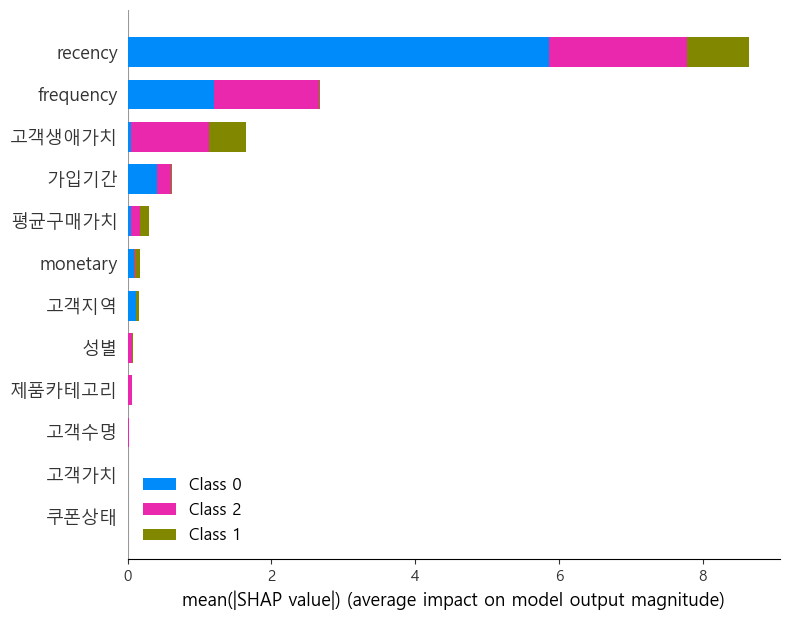

In [103]:
# SHAP을 이용한 모델 예측 설명
best_model = original_grid_lgbm.best_estimator_
explainer = shap.Explainer(best_model)
shap_values = explainer.shap_values(X_test)

# 특성의 이름을 리스트로 생성
feature_names = X_test.columns.tolist()

# SHAP 값을 정렬하여 중요도가 높은 순서대로 시각화
shap.summary_plot(shap_values, X_test, feature_names=feature_names, plot_type="bar", sort=True)
plt.show()